## To run this colab, press the "Runtime" button in the menu tab and then press the "Run all" button.

##### Copyright 2019 The TensorFlow Authors.

In [0]:
#@title Licensed under the Apache License, Version 2.0 (the "License");
# you may not use this file except in compliance with the License.
# You may obtain a copy of the License at
#
# https://www.apache.org/licenses/LICENSE-2.0
#
# Unless required by applicable law or agreed to in writing, software
# distributed under the License is distributed on an "AS IS" BASIS,
# WITHOUT WARRANTIES OR CONDITIONS OF ANY KIND, either express or implied.
# See the License for the specific language governing permissions and
# limitations under the License.

# Recognize Flowers using Transfer Learning

<table class="tfo-notebook-buttons" align="left">
  <td>
    <a target="_blank" href="https://colab.research.google.com/github/tensorflow/examples/blob/master/community/en/flowers_tf_lite.ipynb"><img src="https://www.tensorflow.org/images/colab_logo_32px.png" />Run in Google Colab</a>
  </td>
  <td>
    <a target="_blank" href="https://github.com/tensorflow/examples/blob/master/community/en/flowers_tf_lite.ipynb"><img src="https://www.tensorflow.org/images/GitHub-Mark-32px.png" />View source on GitHub</a>
  </td>
</table>

In [0]:
import tensorflow as tf
assert tf.__version__.startswith('2')

import os
import numpy as np
import matplotlib.pyplot as plt

from IPython.display import clear_output
from tensorflow.keras.callbacks import TensorBoard, ModelCheckpoint

In [0]:
tf.__version__

'2.2.0'

Sometimes the file is cannot be extracted. Run this in that case

In [0]:
# Sync with Kaggle API
from google.colab import files
files.upload()

Saving kaggle.json to kaggle.json


{'kaggle.json': b'{"username":"cindyalifiaputri","key":"4c18feb5a9e547be106c84967592484a"}'}

In [0]:
!pip install -q kaggle
!mkdir -p ~/.kaggle
!cp kaggle.json ~/.kaggle/
!ls ~/.kaggle
!chmod 600 /root/.kaggle/kaggle.json # set permission

kaggle.json


In [0]:
# Download dataset using Kaggle API
!kaggle datasets download -d ashishjangra27/face-mask-12k-images-dataset

 97% 321M/330M [00:11<00:00, 32.8MB/s]
100% 330M/330M [00:11<00:00, 29.6MB/s]


In [0]:
# Unzip file 
!unzip 'face-mask-12k-images-dataset.zip' -d face_mask_image_dataset
clear_output()

## Setup Input Pipeline

Download the flowers dataset.

Use `ImageDataGenerator` to rescale the images.

Create the train generator and specify where the train dataset directory, image size, batch size.

Create the validation generator with similar approach as the train generator with the flow_from_directory() method.

In [0]:
IMAGE_SIZE = 224
BATCH_SIZE = 64

datagen = tf.keras.preprocessing.image.ImageDataGenerator( 
	rescale=1./255,
	rotation_range=20,
	zoom_range=0.15,
	width_shift_range=0.2,
	height_shift_range=0.2,
	shear_range=0.15,
	horizontal_flip=True,
	fill_mode="nearest")

train_generator = datagen.flow_from_directory(
    "/content/face_mask_image_dataset/Face Mask Dataset/Train",
    target_size=(IMAGE_SIZE, IMAGE_SIZE),
    batch_size=BATCH_SIZE)

val_generator = datagen.flow_from_directory(
    "/content/face_mask_image_dataset/Face Mask Dataset/Validation",
    target_size=(IMAGE_SIZE, IMAGE_SIZE),
    batch_size=BATCH_SIZE)

Found 10000 images belonging to 2 classes.
Found 800 images belonging to 2 classes.


In [0]:
for image_batch, label_batch in train_generator:
  break
image_batch.shape, label_batch.shape

((64, 224, 224, 3), (64, 2))

Save the labels in a file which will be downloaded later.

In [0]:
print (train_generator.class_indices)

labels = '\n'.join(sorted(train_generator.class_indices.keys()))

with open('labels.txt', 'w') as f:
  f.write(labels)

{'WithMask': 0, 'WithoutMask': 1}


In [0]:
!cat labels.txt

WithMask
WithoutMask

## Create the base model from the pre-trained convnets

Create the base model from the **MobileNet V2** model developed at Google, and pre-trained on the ImageNet dataset, a large dataset of 1.4M images and 1000 classes of web images.

First, pick which intermediate layer of MobileNet V2 will be used for feature extraction. A common practice is to use the output of the very last layer before the flatten operation, the so-called "bottleneck layer". The reasoning here is that the following fully-connected layers will be too specialized to the task the network was trained on, and thus the features learned by these layers won't be very useful for a new task. The bottleneck features, however, retain much generality.

Let's instantiate an MobileNet V2 model pre-loaded with weights trained on ImageNet. By specifying the `include_top=False` argument, we load a network that doesn't include the classification layers at the top, which is ideal for feature extraction.

In [0]:
IMG_SHAPE = (IMAGE_SIZE, IMAGE_SIZE, 3)

# Create the base model from the pre-trained model MobileNet V2
base_model = tf.keras.applications.MobileNetV2(input_shape=IMG_SHAPE,
                                              include_top=False, 
                                              weights='imagenet')

9412608/9406464 [==============================] - 0s 0us/step


## FINE TUNING
I will freeze the convolutional base created from the previous step and use that as a feature extractor, add a classifier on top of it and train the top-level classifier.

In [0]:
for layer in base_model.layers:
	layer.trainable = False

### Add a classification head

In [0]:
# Mask and WithoutMask
dense = 2

In [0]:
from tensorflow.keras.layers import AveragePooling2D, Dropout, Flatten, Dense
from tensorflow.keras.models import Model

In [0]:
# head_model = tf.keras.Sequential([
#     base_model.output,
# #   tf.keras.layers.Conv2D(32, 3, activation='relu'),

# #   tf.keras.layers.Conv2D(32, 3, activation='relu'),

# #   tf.keras.layers.Dropout(0.5),
# #   tf.keras.layers.Dense(50, activation='relu'),
# #   tf.keras.layers.GlobalAveragePooling2D(),
# #   tf.keras.layers.Dense(dense, activation='softmax')
#     AveragePooling2D(pool_size=(7, 7)),
#     Flatten(name="flatten"),
#     Dense(128, activation="relu"),
#     Dropout(0.5),
#     Dense(2, activation="softmax")
# ])

headModel = base_model.output
headModel = AveragePooling2D(pool_size=(7, 7))(headModel)
headModel = Flatten(name="flatten")(headModel)
headModel = Dense(128, activation="relu")(headModel)
headModel = Dropout(0.5)(headModel)
headModel = Dense(2, activation="softmax")(headModel)

print('Base model ready')

Base model ready


In [0]:
# place the head FC model on top of the base model (this will become
# the actual model we will train)
model = Model(inputs=base_model.input, outputs=headModel)

### Compile the model

You must compile the model before training it.  Since there are multiple classes, use a categorical cross-entropy loss.

In [0]:
model.compile(optimizer=tf.keras.optimizers.Adam(), 
              loss='binary_crossentropy', 
              metrics=['accuracy'])

In [0]:
model.summary()

Model: "model"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_1 (InputLayer)            [(None, 224, 224, 3) 0                                            
__________________________________________________________________________________________________
Conv1_pad (ZeroPadding2D)       (None, 225, 225, 3)  0           input_1[0][0]                    
__________________________________________________________________________________________________
Conv1 (Conv2D)                  (None, 112, 112, 32) 864         Conv1_pad[0][0]                  
__________________________________________________________________________________________________
bn_Conv1 (BatchNormalization)   (None, 112, 112, 32) 128         Conv1[0][0]                      
______________________________________________________________________________________________

In [0]:
checkpoint = ModelCheckpoint('model.{epoch:02d}-{val_loss:.2f}.h5',
                             monitor='val_loss',
                             verbose=0,
                             save_best_only=True,
                             mode='auto')

In [0]:
print('Number of trainable variables = {}'.format(len(model.trainable_variables)))

Number of trainable variables = 4


### Train the model

<!-- TODO(markdaoust): delete steps_per_epoch in TensorFlow r1.14/r2.0 -->

In [0]:
epochs = 5

history = model.fit(train_generator, 
                    steps_per_epoch=len(train_generator), 
                    epochs=epochs, 
                    validation_data=val_generator, 
                    validation_steps=len(val_generator),
                    callbacks=[checkpoint])

Epoch 1/5
157/157 [==============================] - 413s 3s/step - loss: 0.0262 - accuracy: 0.9903 - val_loss: 0.0116 - val_accuracy: 0.9950
Epoch 2/5
157/157 [==============================] - 422s 3s/step - loss: 0.0215 - accuracy: 0.9925 - val_loss: 0.0131 - val_accuracy: 0.9925
Epoch 3/5
157/157 [==============================] - 420s 3s/step - loss: 0.0243 - accuracy: 0.9918 - val_loss: 0.0189 - val_accuracy: 0.9925
Epoch 4/5
157/157 [==============================] - 404s 3s/step - loss: 0.0199 - accuracy: 0.9933 - val_loss: 0.0110 - val_accuracy: 0.9975
Epoch 5/5
157/157 [==============================] - 405s 3s/step - loss: 0.0217 - accuracy: 0.9925 - val_loss: 0.0095 - val_accuracy: 0.9975


### Learning curves

Let's take a look at the learning curves of the training and validation accuracy/loss when using the MobileNet V2 base model as a fixed feature extractor. 

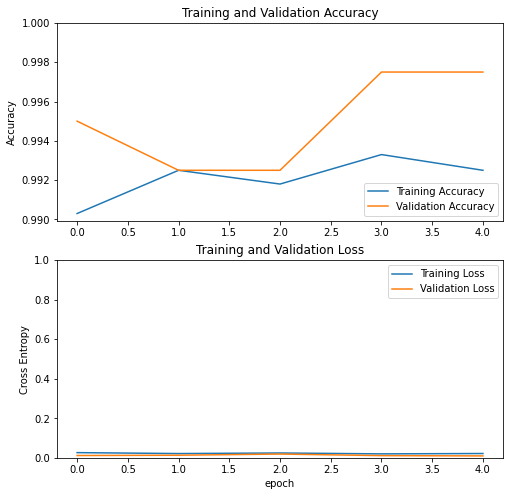

In [0]:
acc = history.history['accuracy']
val_acc = history.history['val_accuracy']

loss = history.history['loss']
val_loss = history.history['val_loss']

plt.figure(figsize=(8, 8))
plt.subplot(2, 1, 1)
plt.plot(acc, label='Training Accuracy')
plt.plot(val_acc, label='Validation Accuracy')
plt.legend(loc='lower right')
plt.ylabel('Accuracy')
plt.ylim([min(plt.ylim()),1])
plt.title('Training and Validation Accuracy')

plt.subplot(2, 1, 2)
plt.plot(loss, label='Training Loss')
plt.plot(val_loss, label='Validation Loss')
plt.legend(loc='upper right')
plt.ylabel('Cross Entropy')
plt.ylim([0,1.0])
plt.title('Training and Validation Loss')
plt.xlabel('epoch')
plt.show()

## Transfer Learning
## DON'T RUN THIS CELL
In our top experiment which is FINE TUNING step, I was only training a few layers on top of an MobileNet V2 base model. The weights of the pre-trained network were **NOT** updated during training.

One way to increase performance even further is to train (or "fine-tune") the weights of the top layers of the pre-trained model alongside the training of the classifier you added. The training process will force the weights to be tuned from generic features maps to features associated specifically to our dataset. 

Before, I've try to use transfer learning to improve prediction. Yes, that the prediction got pretty high accuracy, but actually the model is **NOT GOOD** about predicting a new data testing.

### Un-freeze the top layers of the model


All you need to do is unfreeze the `base_model` and set the bottom layers be un-trainable. Then, recompile the model (necessary for these changes to take effect), and resume training.

In [0]:
base_model.trainable = True

In [0]:
# Let's take a look to see how many layers are in the base model
print("Number of layers in the base model: ", len(base_model.layers))

# Fine tune from this layer onwards
fine_tune_at = 100

print("Layers to train: ", len(base_model.layers) - len(base_model.layers[:fine_tune_at]))

# Freeze all the layers before the `fine_tune_at` layer
for layer in base_model.layers[:fine_tune_at]:
  layer.trainable =  False

Number of layers in the base model:  155
Layers to train:  55


### Compile the model

Compile the model using a much lower training rate.

In [0]:
model.compile(loss='categorical_crossentropy',
              optimizer = tf.keras.optimizers.Adam(1e-5),
              metrics=['accuracy'])

In [0]:
model.summary()

Model: "sequential_10"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
mobilenetv2_1.00_224 (Model) (None, 7, 7, 1280)        2257984   
_________________________________________________________________
conv2d_15 (Conv2D)           (None, 5, 5, 32)          368672    
_________________________________________________________________
conv2d_16 (Conv2D)           (None, 3, 3, 32)          9248      
_________________________________________________________________
dropout_10 (Dropout)         (None, 3, 3, 32)          0         
_________________________________________________________________
dense_17 (Dense)             (None, 3, 3, 50)          1650      
_________________________________________________________________
global_average_pooling2d_7 ( (None, 50)                0         
_________________________________________________________________
dense_18 (Dense)             (None, 2)               

In [0]:
print('Number of trainable variables = {}'.format(len(model.trainable_variables)))

Number of trainable variables = 64


### Continue Train the model

In [0]:
history_fine = model.fit(train_generator, 
                         steps_per_epoch=len(train_generator), 
                         epochs=5, 
                         validation_data=val_generator, 
                         validation_steps=len(val_generator))

Epoch 1/5
125/125 [==============================] - 543s 4s/step - loss: 0.4740 - accuracy: 0.9309 - val_loss: 0.3122 - val_accuracy: 0.9492
Epoch 2/5
125/125 [==============================] - 536s 4s/step - loss: 0.0379 - accuracy: 0.9895 - val_loss: 0.3032 - val_accuracy: 0.9391
Epoch 3/5
125/125 [==============================] - 538s 4s/step - loss: 0.0193 - accuracy: 0.9936 - val_loss: 0.3286 - val_accuracy: 0.9391
Epoch 4/5
125/125 [==============================] - 536s 4s/step - loss: 0.0112 - accuracy: 0.9966 - val_loss: 0.2014 - val_accuracy: 0.9594
Epoch 5/5
125/125 [==============================] - 535s 4s/step - loss: 0.0055 - accuracy: 0.9976 - val_loss: 0.1366 - val_accuracy: 0.9695


 ## Convert to TFLite

Saved the model using `tf.saved_model.save` and then convert the saved model to a tf lite compatible format.

In [0]:
saved_model_dir = '/content/save/fine_tuning_mobilenetv2'
tf.saved_model.save(model, saved_model_dir)

converter = tf.lite.TFLiteConverter.from_saved_model(saved_model_dir)
tflite_model = converter.convert()

with open('model.tflite', 'wb') as f:
  f.write(tflite_model)

INFO:tensorflow:Assets written to: /content/save/fine_tuning_mobilenetv2/assets


INFO:tensorflow:Assets written to: /content/save/fine_tuning_mobilenetv2/assets


Download the converted model and labels

In [0]:
from google.colab import files

files.download('model.tflite')
files.download('labels.txt')

In [0]:
model.save('model.05-0.00.h5')

In [0]:
!zip -r /content/fine_tuning_mobilenetv2.zip /content/save/fine_tuning_mobilenetv2
files.download("/content/fine_tuning_mobilenetv2.zip")

  adding: content/save/fine_tuning_mobilenetv2/ (stored 0%)
  adding: content/save/fine_tuning_mobilenetv2/saved_model.pb (deflated 92%)
  adding: content/save/fine_tuning_mobilenetv2/assets/ (stored 0%)
  adding: content/save/fine_tuning_mobilenetv2/variables/ (stored 0%)
  adding: content/save/fine_tuning_mobilenetv2/variables/variables.data-00000-of-00001 (deflated 9%)
  adding: content/save/fine_tuning_mobilenetv2/variables/variables.index (deflated 77%)


Let's take a look at the learning curves of the training and validation accuracy/loss, when fine tuning the last few layers of the MobileNet V2 base model and training the classifier on top of it. The validation loss is much higher than the training loss, so you may get some overfitting.

You may also get some overfitting as the new training set is relatively small and similar to the original MobileNet V2 datasets.


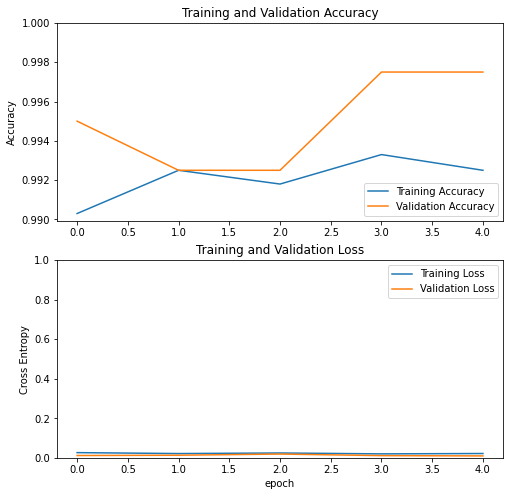

In [0]:
acc = history.history['accuracy']
val_acc = history.history['val_accuracy']

loss = history.history['loss']
val_loss = history.history['val_loss']

plt.figure(figsize=(8, 8))
plt.subplot(2, 1, 1)
plt.plot(acc, label='Training Accuracy')
plt.plot(val_acc, label='Validation Accuracy')
plt.legend(loc='lower right')
plt.ylabel('Accuracy')
plt.ylim([min(plt.ylim()),1])
plt.title('Training and Validation Accuracy')

plt.subplot(2, 1, 2)
plt.plot(loss, label='Training Loss')
plt.plot(val_loss, label='Validation Loss')
plt.legend(loc='upper right')
plt.ylabel('Cross Entropy')
plt.ylim([0,1.0])
plt.title('Training and Validation Loss')
plt.xlabel('epoch')
plt.show()

## Summary:

* **Using a pre-trained model for feature extraction**:  When working with a small dataset, it is common to take advantage of features learned by a model trained on a larger dataset in the same domain. This is done by instantiating the pre-trained model and adding a fully-connected classifier on top. The pre-trained model is "frozen" and only the weights of the classifier get updated during training.
In this case, the convolutional base extracted all the features associated with each image and you just trained a classifier that determines the image class given that set of extracted features.

* **Fine-tuning a pre-trained model**: To further improve performance, one might want to repurpose the top-level layers of the pre-trained models to the new dataset via fine-tuning.
In this case, you tuned your weights such that your model learned high-level features specific to the dataset. This technique is usually recommended when the training dataset is large and very similar to the orginial dataset that the pre-trained model was trained on.


# Prediction
This step I going to predict the model that I already save which is 'model.10-0.14.h5'. We'll gonna see the result of prediction from some sample of data testing 

In [0]:
import numpy as np
from tensorflow.keras.models import load_model
from keras.preprocessing import image
import matplotlib.pyplot as plt 

from google.colab import files

# Directory
from os import listdir

# Image Processing
from tensorflow.keras.preprocessing.image import load_img
from sklearn.utils import shuffle
from matplotlib import rcParams

Using TensorFlow backend.


In [0]:
def loadImages(list_path):
    # return list of images

    # Based URL
    URL = "/content/face_mask_image_dataset/Face Mask Dataset/"
    loadedImages=[]

    # Read each Image and get to the list
    for path in list_path:
      print("[INFO] loading "+path+" dataset . . . ")
      imagesList = listdir(URL+path)
      temp = []
      for image in imagesList:
          # img = mpimg.imread(URL+path +"/"+ image)
          img = load_img(URL+path +"/"+ image, target_size=(224, 224))
          temp.append(img)
      loadedImages+=temp

    return loadedImages

In [0]:

def class_result(list_predict):
    """
    Function to define class of shapes
    """
    list_predict = list_predict.tolist()
    if list_predict.index(max(list_predict)) == 0:
        return 'WithMask'
    elif list_predict.index(max(list_predict)) == 1:
        return 'WithoutMask'


def predict_class(img_name, model):
    """
    Function to predict new image
    """
    test_image = image.img_to_array(img_name)
    test_image = np.expand_dims(test_image, axis=0)
    test_image /= 255.
    result = model.predict(test_image)
    plt.figure(figsize=(3,3))
    plt.imshow(img_name)
    plt.show()
    print('Predicted : ', class_result(result[0]))

## Load testing data

In [0]:
# Define URL for data test
df_test = loadImages(["Test/WithMask","Test/WithoutMask"])
df_test = shuffle(df_test, random_state=0)

[INFO] loading Test/WithMask dataset . . . 
[INFO] loading Test/WithoutMask dataset . . . 


### Show the example of testing data 

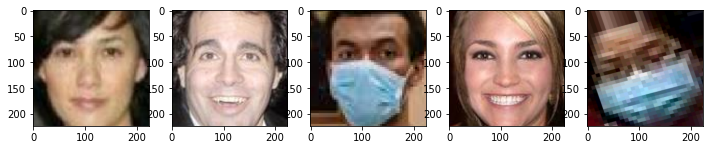

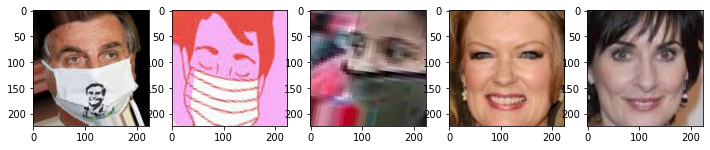

In [0]:
# Show the example of image in data train
%matplotlib inline

shuffle(df_test)

n_image=5

# figure size in inches optional
rcParams['figure.figsize'] = 12 ,12

# display images
fig, ax = plt.subplots(1,n_image)

for i in range(n_image):
    ax[i].imshow(df_test[i]);

# display images
fig, ax = plt.subplots(1,n_image)

for i in range(n_image):
    ax[i].imshow(df_test[i+5]);

### Load another sample of testing data 

In [0]:
# Upload the model
files.upload()

Saving model.10-0.14.h5 to model.10-0.14 (1).h5


In [0]:
files.upload()

Saving msk.jpg to msk (1).jpg


{'msk.jpg': b'\xff\xd8\xff\xe0\x00\x10JFIF\x00\x01\x01\x00\x00\x01\x00\x01\x00\x00\xff\xe1S\x11Exif\x00\x00MM\x00*\x00\x00\x00\x08\x00\x0b\x01\x10\x00\x02\x00\x00\x00\x0c\x00\x00\x00\x92\x011\x00\x02\x00\x00\x00(\x00\x00\x00\x9e\x01\x12\x00\x03\x00\x00\x00\x01\x00\x08\x00\x00\x012\x00\x02\x00\x00\x00\x14\x00\x00\x00\xc6\x02\x13\x00\x03\x00\x00\x00\x01\x00\x01\x00\x00\x87i\x00\x04\x00\x00\x00\x01\x00\x00\x00\xef\x01(\x00\x03\x00\x00\x00\x01\x00\x02\x00\x00\x88%\x00\x04\x00\x00\x00\x01\x00\x00\x02\xd0\x01\x1a\x00\x05\x00\x00\x00\x01\x00\x00\x00\xda\x01\x1b\x00\x05\x00\x00\x00\x01\x00\x00\x00\xe2\x01\x0f\x00\x02\x00\x00\x00\x05\x00\x00\x00\xea\x00\x00\x03\xadASUS_X01BDA\x00sdm660_64-user 9 PKQ1 1684 release-keys\x002020:05:27 20:11:58\x00\x00\x00\x00H\x00\x00\x00\x01\x00\x00\x00H\x00\x00\x00\x01asus\x00\x00\x1c\x88\'\x00\x03\x00\x00\x00\x01\x05 \x00\x00\x88"\x00\x03\x00\x00\x00\x01\x00\x00\x00\x00\x82\x9d\x00\x05\x00\x00\x00\x01\x00\x00\x02E\x82\x9a\x00\x05\x00\x00\x00\x01\x00\x00\x02M\xa

In [0]:
# Upload testing data from local
files.upload()

In [0]:
files.upload()

Saving nmsk2.jpg to nmsk2 (2).jpg


{'nmsk2.jpg': b'\xff\xd8\xff\xe0\x00\x10JFIF\x00\x01\x01\x00\x00\x01\x00\x01\x00\x00\xff\xe1-:Exif\x00\x00MM\x00*\x00\x00\x00\x08\x00\x0b\x01\x10\x00\x02\x00\x00\x00\x0c\x00\x00\x00\x92\x011\x00\x02\x00\x00\x00(\x00\x00\x00\x9e\x01\x12\x00\x03\x00\x00\x00\x01\x00\x01\x00\x00\x012\x00\x02\x00\x00\x00\x14\x00\x00\x00\xc6\x02\x13\x00\x03\x00\x00\x00\x01\x00\x01\x00\x00\x87i\x00\x04\x00\x00\x00\x01\x00\x00\x00\xef\x01(\x00\x03\x00\x00\x00\x01\x00\x02\x00\x00\x88%\x00\x04\x00\x00\x00\x01\x00\x00\x02\xd0\x01\x1a\x00\x05\x00\x00\x00\x01\x00\x00\x00\xda\x01\x1b\x00\x05\x00\x00\x00\x01\x00\x00\x00\xe2\x01\x0f\x00\x02\x00\x00\x00\x05\x00\x00\x00\xea\x00\x00\x03\xa9ASUS_X01BDA\x00sdm660_64-user 9 PKQ1 1684 release-keys\x002020:05:26 17:01:59\x00\x00\x00\x00H\x00\x00\x00\x01\x00\x00\x00H\x00\x00\x00\x01asus\x00\x00\x1c\x88\'\x00\x03\x00\x00\x00\x01\x07\xdd\x00\x00\x88"\x00\x03\x00\x00\x00\x01\x00\x00\x00\x00\x82\x9d\x00\x05\x00\x00\x00\x01\x00\x00\x02E\x82\x9a\x00\x05\x00\x00\x00\x01\x00\x00\x02M\

In [0]:
img = []
img_1=load_img('/content/msk.jpg', target_size=(224, 224))
img.append(img_1)
img_2=load_img('/content/nmsk.jpg', target_size=(224, 224))
img.append(img_2)
img_3=load_img('/content/nmsk2 (2).jpg', target_size=(224, 224))
img.append(img_3)

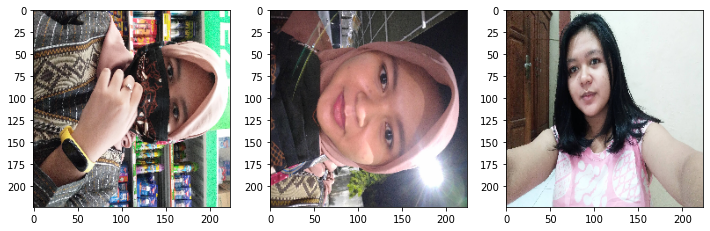

In [0]:
n_image=3
# display images

fig, ax = plt.subplots(1,n_image)

for i in range(n_image):
    ax[i].imshow(img[i]);

## Load Model

In [0]:
# Load model
model = load_model('model.05-0.00.h5')

## Call predict function

### Try predict with testing data

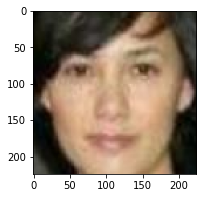

Predicted :  WithoutMask


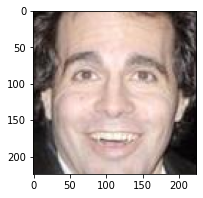

Predicted :  WithoutMask


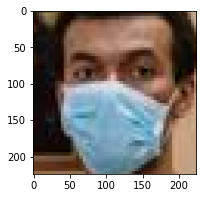

Predicted :  WithMask


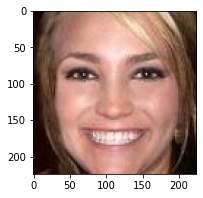

Predicted :  WithoutMask


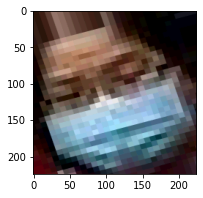

Predicted :  WithMask


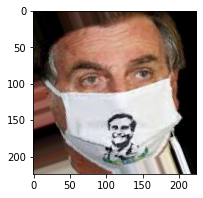

Predicted :  WithMask


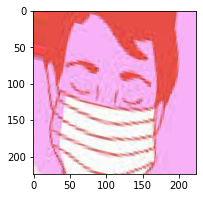

Predicted :  WithMask


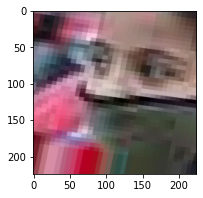

Predicted :  WithMask


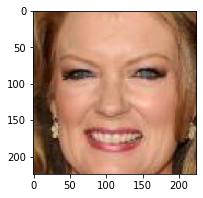

Predicted :  WithoutMask


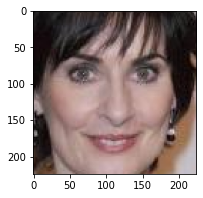

Predicted :  WithoutMask


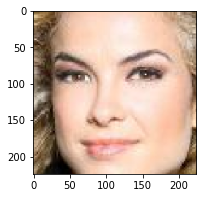

Predicted :  WithoutMask


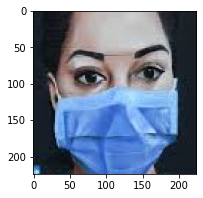

Predicted :  WithMask


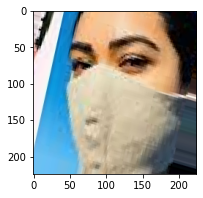

Predicted :  WithMask


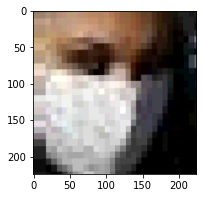

Predicted :  WithMask


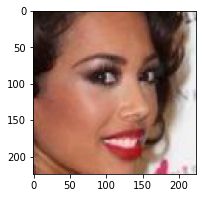

Predicted :  WithoutMask


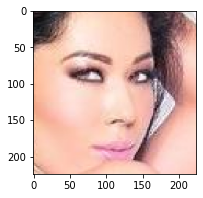

Predicted :  WithoutMask


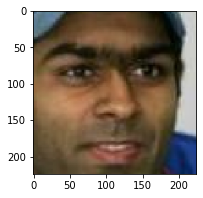

Predicted :  WithoutMask


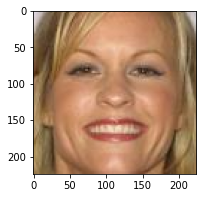

Predicted :  WithoutMask


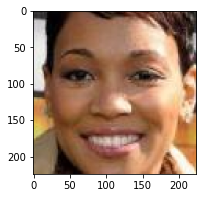

Predicted :  WithoutMask


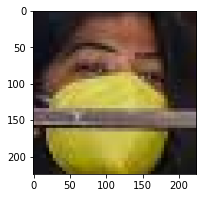

Predicted :  WithMask


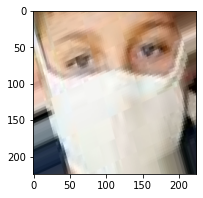

Predicted :  WithMask


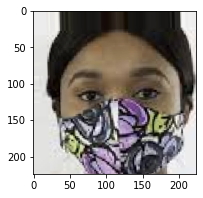

Predicted :  WithMask


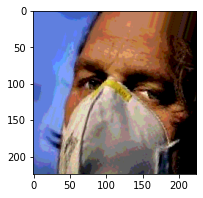

Predicted :  WithMask


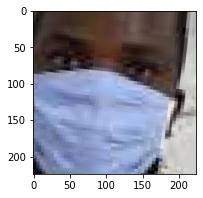

Predicted :  WithMask


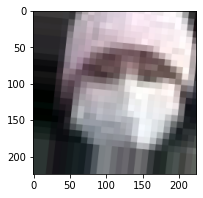

Predicted :  WithMask


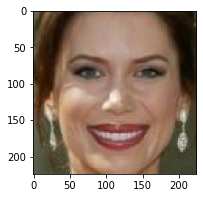

Predicted :  WithoutMask


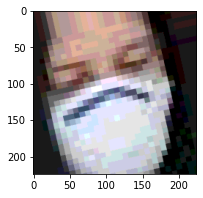

Predicted :  WithMask


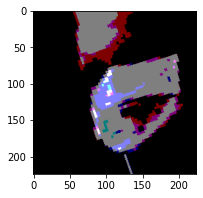

Predicted :  WithMask


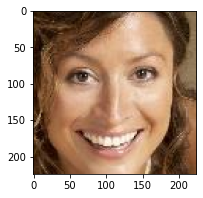

Predicted :  WithoutMask


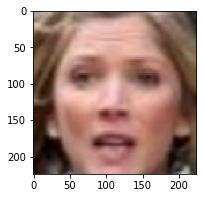

Predicted :  WithoutMask


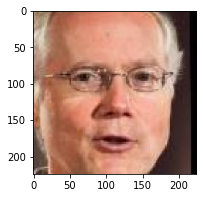

Predicted :  WithoutMask


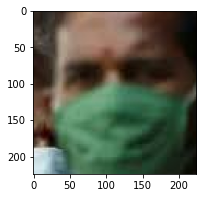

Predicted :  WithMask


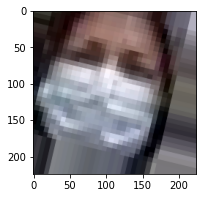

Predicted :  WithMask


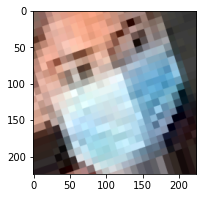

Predicted :  WithMask


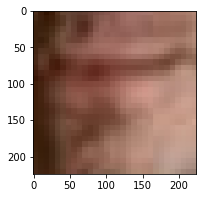

Predicted :  WithMask


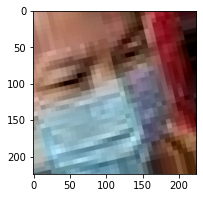

Predicted :  WithMask


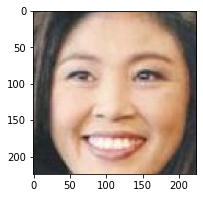

Predicted :  WithoutMask


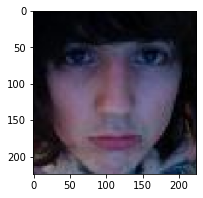

Predicted :  WithoutMask


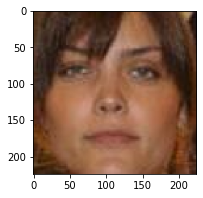

Predicted :  WithoutMask


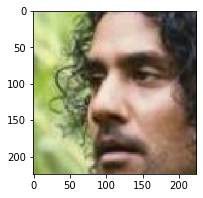

Predicted :  WithoutMask


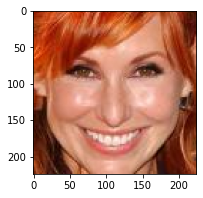

Predicted :  WithoutMask


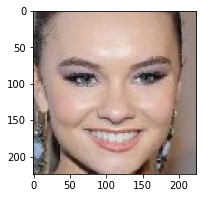

Predicted :  WithoutMask


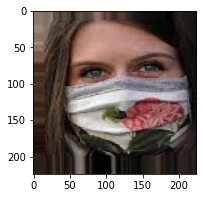

Predicted :  WithMask


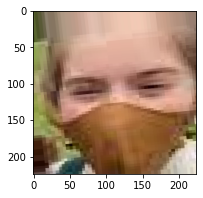

Predicted :  WithMask


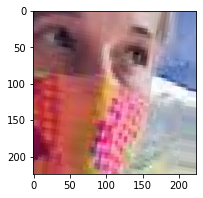

Predicted :  WithMask


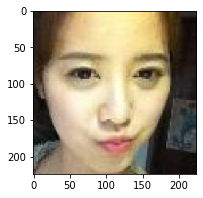

Predicted :  WithoutMask


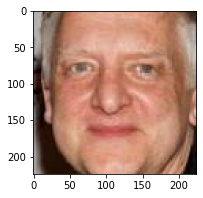

Predicted :  WithoutMask


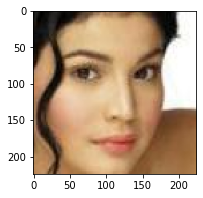

Predicted :  WithoutMask


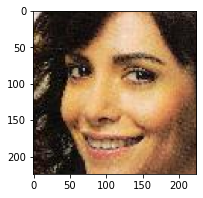

Predicted :  WithoutMask


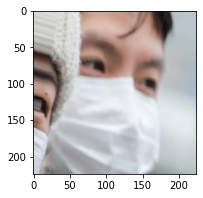

Predicted :  WithMask


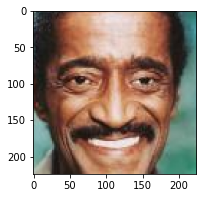

Predicted :  WithoutMask


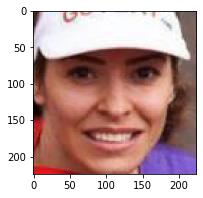

Predicted :  WithoutMask


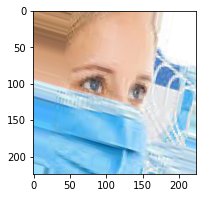

Predicted :  WithMask


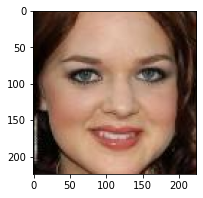

Predicted :  WithoutMask


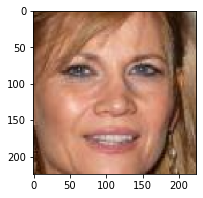

Predicted :  WithoutMask


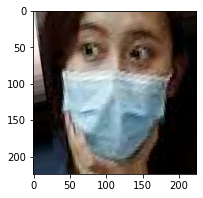

Predicted :  WithMask


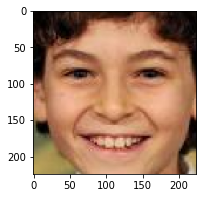

Predicted :  WithoutMask


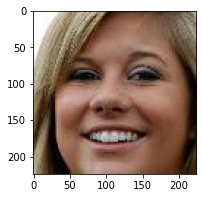

Predicted :  WithoutMask


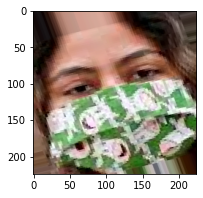

Predicted :  WithMask


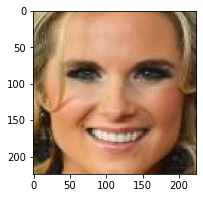

Predicted :  WithoutMask


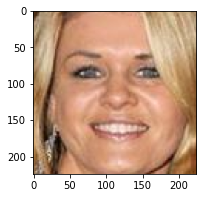

Predicted :  WithoutMask


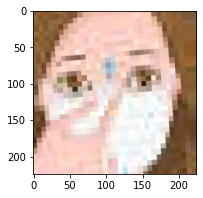

Predicted :  WithMask


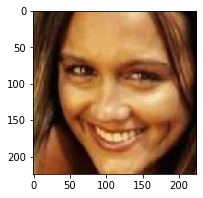

Predicted :  WithoutMask


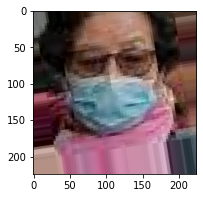

Predicted :  WithMask


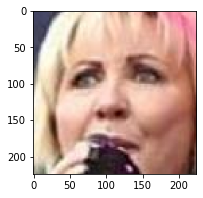

Predicted :  WithoutMask


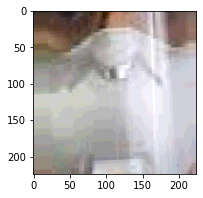

Predicted :  WithMask


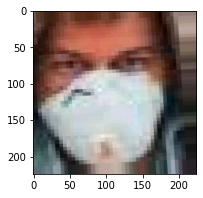

Predicted :  WithMask


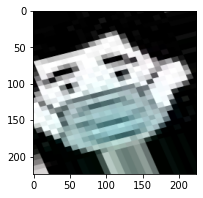

Predicted :  WithMask


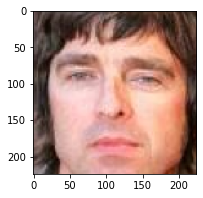

Predicted :  WithoutMask


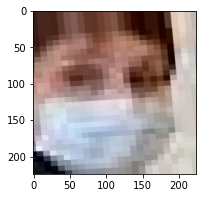

Predicted :  WithMask


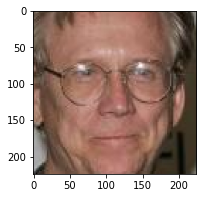

Predicted :  WithoutMask


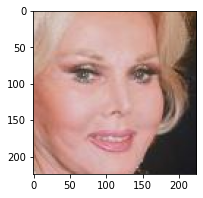

Predicted :  WithoutMask


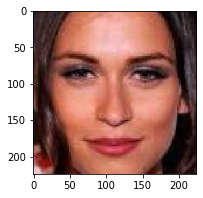

Predicted :  WithoutMask


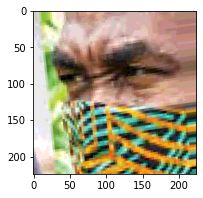

Predicted :  WithMask


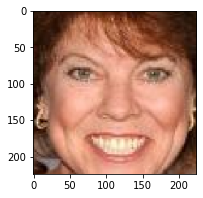

Predicted :  WithoutMask


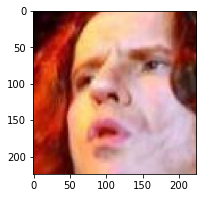

Predicted :  WithoutMask


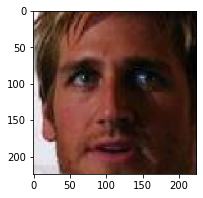

Predicted :  WithoutMask


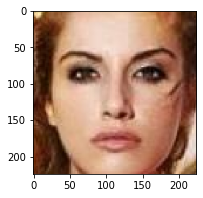

Predicted :  WithoutMask


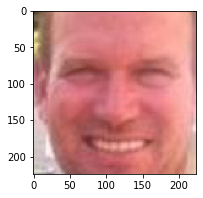

Predicted :  WithoutMask


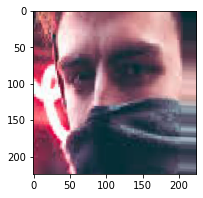

Predicted :  WithMask


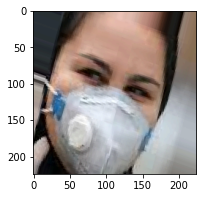

Predicted :  WithMask


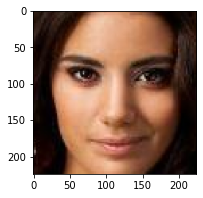

Predicted :  WithoutMask


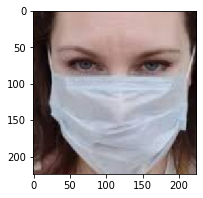

Predicted :  WithMask


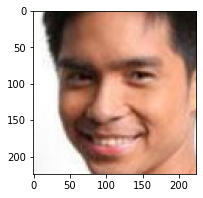

Predicted :  WithoutMask


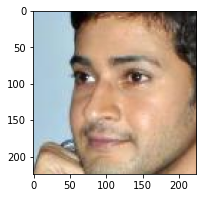

Predicted :  WithoutMask


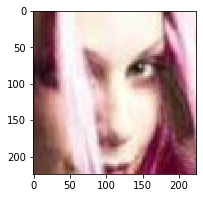

Predicted :  WithoutMask


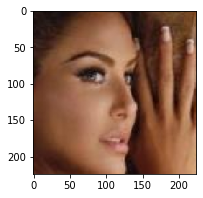

Predicted :  WithoutMask


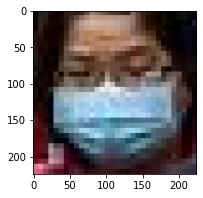

Predicted :  WithMask


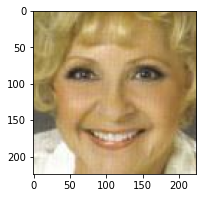

Predicted :  WithoutMask


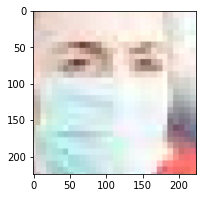

Predicted :  WithMask


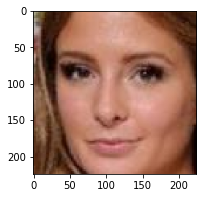

Predicted :  WithoutMask


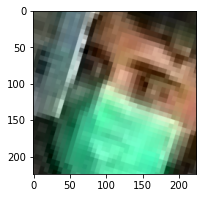

Predicted :  WithMask


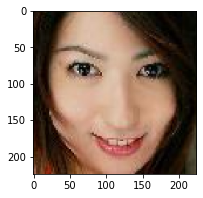

Predicted :  WithoutMask


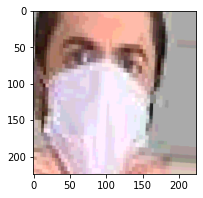

Predicted :  WithMask


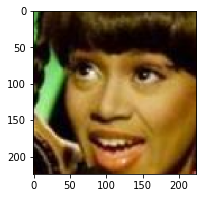

Predicted :  WithoutMask


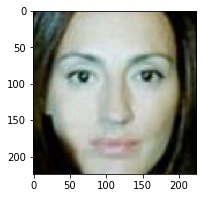

Predicted :  WithoutMask


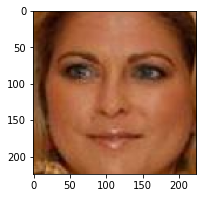

Predicted :  WithoutMask


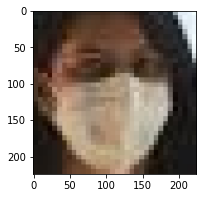

Predicted :  WithMask


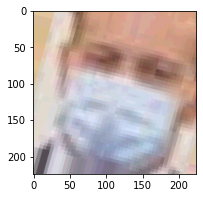

Predicted :  WithMask


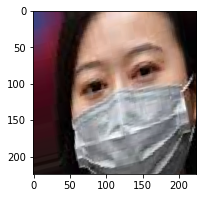

Predicted :  WithMask


In [0]:
# Classify
for i in range (100):
    predict_class(df_test[i], model)

### Try predict with another sample

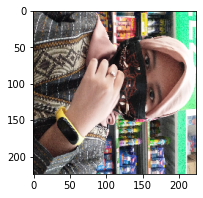

Predicted :  WithMask


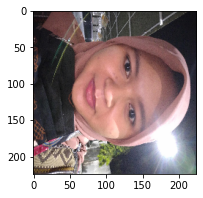

Predicted :  WithMask


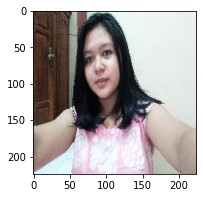

Predicted :  WithMask


In [0]:
# Classify
for i in range (3):
    predict_class(img[i], model)

# Face Detection

In [0]:
# from cv2 import *
import cv2
from google.colab import files
from tensorflow.keras.preprocessing.image import load_img
from tensorflow.keras.models import load_model
import numpy as np
import matplotlib.pyplot as plt


## Load model face mask prediction

In [0]:
# Load model
model = load_model('/content/model.10-0.14.h5')

## Build class for face detector

In [0]:
class FaceDetector():

    def __init__(self,faceCascadePath):
        self.faceCascade=cv2.CascadeClassifier(faceCascadePath)


    def detect(self, image, scaleFactor=1.1,
               minNeighbors=5,
               minSize=(30,30)):
        
        #function return rectangle coordinates of faces for given image
        rects=self.faceCascade.detectMultiScale(image,
                                                scaleFactor=scaleFactor,
                                                minNeighbors=minNeighbors,
                                                minSize=minSize)
        return rects

## Load model for face detection

In [0]:
#Frontal face of haar cascade loaded
frontal_cascade_path="/content/haarcascade_frontalface_default.xml"

#Detector object created
fd=FaceDetector(frontal_cascade_path)

In [0]:
def get_photos(URL):
    national_team_org=cv2.imread(URL)
    return np.copy(national_team_org)

In [0]:
# #An image contains faces, loaded
# national_team_org=cv2.imread("/content/timnas.jpg")

# def get_national_team():
#     return np.copy(national_team_org)

def show_image(image):
    plt.figure(figsize=(18,15))
    #Before showing image, bgr color order transformed to rgb order
    plt.imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
    plt.xticks([])
    plt.yticks([])
    plt.show()

In [0]:
def predict_class(img_name, model):
    """
    Function to predict new image
    """
    result = model.predict(img_name)
    list_predict=result[0]
    list_predict = list_predict.tolist()
    return list_predict

In [0]:
def detect_face(image, scaleFactor, minNeighbors, minSize):
    # face will detected in gray image
    image_gray=cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)

    faces=fd.detect(image_gray,
                   scaleFactor=scaleFactor,
                   minNeighbors=minNeighbors,
                   minSize=minSize)

    for x, y, w, h in faces:
        #detected faces shown in color image
        # cv2.rectangle(image, (startX, startY), (endX, endY), color, 2)
        # cv2.rectangle(image,(x,y),(x+w, y+h),(127, 255,0),3)
        startX=x
        startY=y

        endX=x+w
        endY=y+h

        # extract the face ROI, convert it from BGR to RGB channel
        # ordering, resize it to 224x224, and preprocess it
        face = image[startY:endY, startX:endX]
        # show_image(face)
        face = cv2.cvtColor(face, cv2.COLOR_BGR2RGB)
        face = cv2.resize(face, (224, 224))
        face = np.expand_dims(face, axis=0)

        # pass the face through the model to determine if the face
        # has a mask or not
        (mask, withoutMask) = predict_class(face, model)

        # determine the class label and color we'll use to draw
        # the bounding box and text
        label = "Mask" if mask > withoutMask else "No Mask"
        color = (0, 255, 0) if label == "Mask" else (0, 0, 255)

        # include the probability in the label
        label = "{}: {:.2f}%".format(label, max(mask, withoutMask) * 100)

        # display the label and bounding box rectangle on the output
        # frame
        cv2.putText(image, label, (startX, startY - 10),
        cv2.FONT_HERSHEY_SIMPLEX, 0.45, color, 2)
        cv2.rectangle(image, (startX, startY), (endX, endY), color, 2)
        # cv2.rectangle(image,(x,y),(x+w, y+h),(127, 255,0),3)

    show_image(image)
    

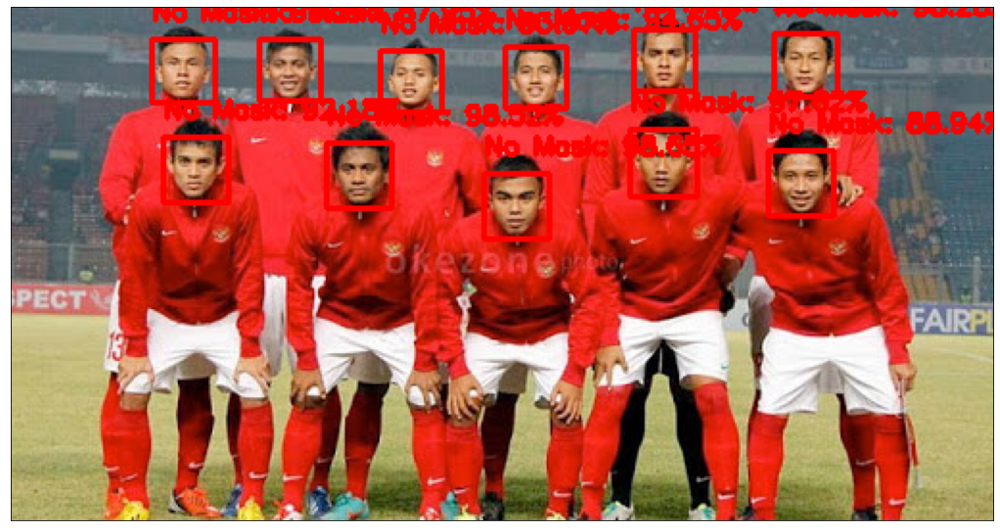

In [0]:
national_team=get_national_team()
#Let's play around function parameters
detect_face(image=national_team, 
            scaleFactor=1.01, 
            minNeighbors=3, 
            minSize=(30,30))

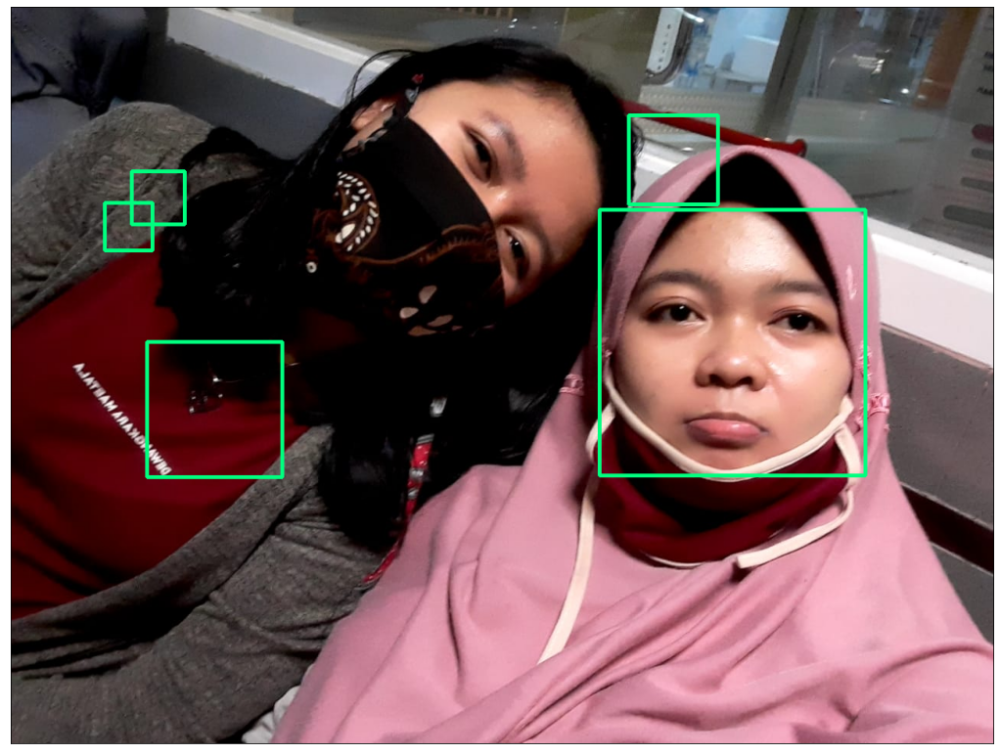

In [0]:
national_team=get_photos("/content/testCase1.jpeg")
#Let's play around function parameters
detect_face(image=national_team, 
            scaleFactor=1.01, 
            minNeighbors=3, 
            minSize=(30,30))

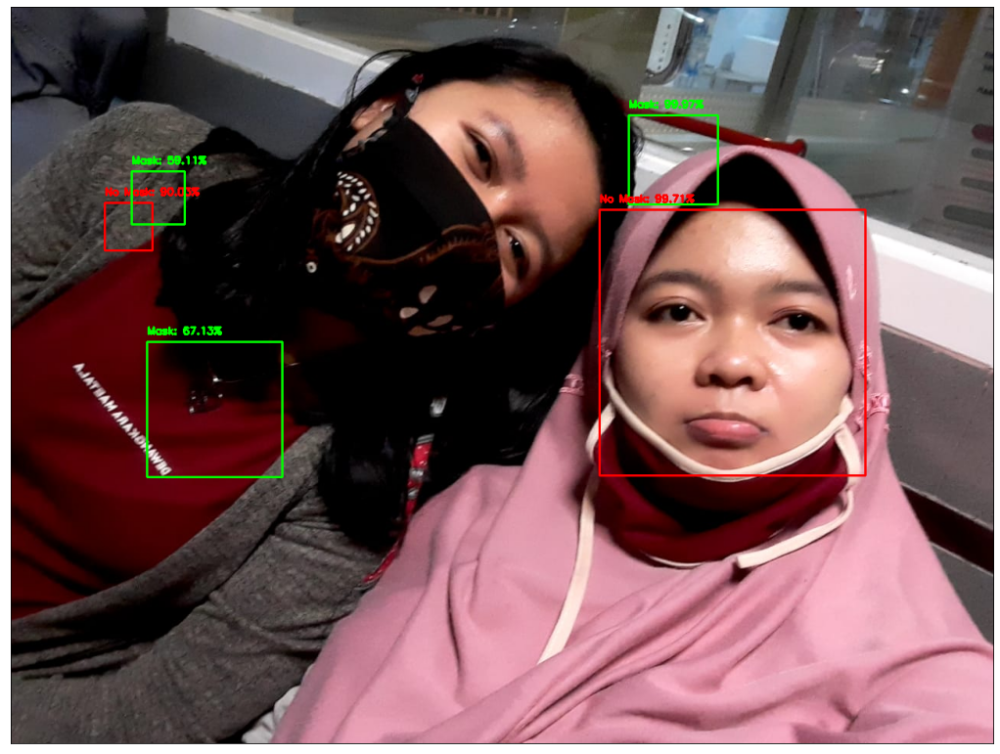

In [0]:
national_team=get_photos("/content/testCase1.jpeg")
#Let's play around function parameters
detect_face(image=national_team, 
            scaleFactor=1.01, 
            minNeighbors=3, 
            minSize=(30,30))

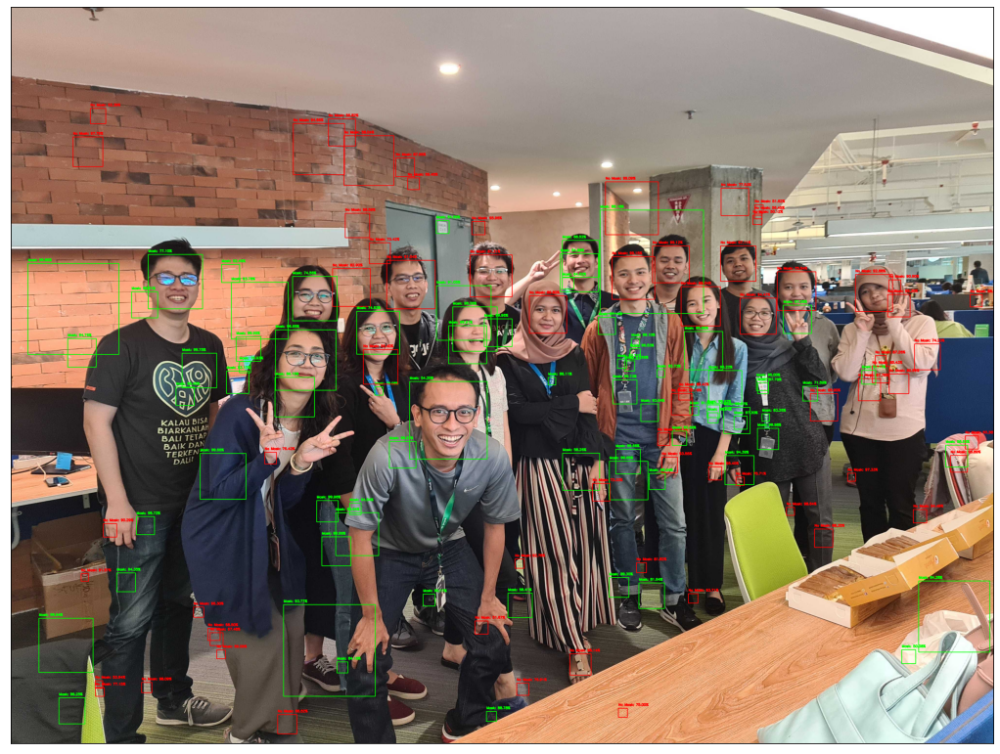

In [0]:
national_team=get_photos("/content/testCase3.jpg")
#Let's play around function parameters
detect_face(image=national_team, 
            scaleFactor=1.01, 
            minNeighbors=3, 
            minSize=(30,30))